In [3]:
import pandas as pd
import scipy.io
import numpy as np
import matplotlib.pyplot as plt

In [5]:
mat['fea'].shape

(9298, 256)

In [6]:
mat['gnd'].shape

(9298, 1)

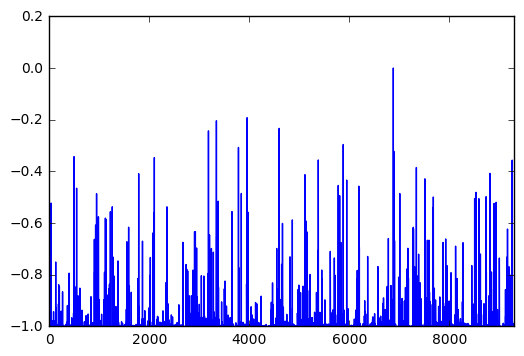

In [9]:
df_features[0].plot()
plt.show()

In [10]:
df_gnd.shape

(9298, 1)

In [11]:
df_gnd[0].unique()

array([ 7,  6,  5,  8,  4,  2,  1,  9,  3, 10])

In [12]:
df_features.shape

(9298, 256)

In [13]:
df_features.head()

,0,1,2,3,4,5,6,7,8,9,...,246,247,248,249,250,251,252,253,254,255
0,-1.000000,-1.000000,-1.000000,-0.999997,-0.999729,-0.989537,-0.860165,-0.395924,0.048299,-0.282151,...,0.131298,0.384728,0.433073,0.193397,-0.237439,-0.649848,-0.906359,-0.988672,-0.999475,-0.999994
1,-0.999927,-0.993644,-0.900309,-0.632621,-0.443145,-0.454436,-0.474872,-0.431176,-0.494539,-0.583648,...,-0.388084,-0.273639,0.001094,0.294825,0.316915,0.113494,-0.092331,-0.329390,-0.584681,-0.868793
2,-1.000000,-1.000000,-1.000000,-0.999995,-0.999986,-0.999987,-0.999990,-0.999316,-0.976299,-0.725917,...,-0.999778,-0.988816,-0.821857,-0.277379,0.136501,-0.247816,-0.809498,-0.988116,-0.999864,-1.000000
3,-0.999998,-0.999800,-0.994136,-0.932288,-0.673685,-0.192056,0.218820,0.337224,0.193371,-0.065072,...,-0.373861,0.196530,0.002823,-0.695900,-0.976372,-0.999458,-0.999996,-1.000000,-1.000000,-1.000000
4,-1.000000,-0.999971,-0.997452,-0.957499,-0.801681,-0.510623,-0.107965,0.217262,0.216431,-0.008529,...,0.214362,0.339240,0.458489,0.473456,0.372240,0.173322,-0.144182,-0.542254,-0.863031,-0.981978


In [14]:
train_features= df_features.iloc[:7291] 

In [15]:
test_features= df_features.iloc[-2007:]

In [16]:
train_decisions= df_gnd.iloc[:7291] 
test_decisions= df_gnd.iloc[-2007:] 

In [17]:
#feature scaling
from sklearn.preprocessing import StandardScaler
sc_X = StandardScaler()
train_features = sc_X.fit_transform(train_features)
test_features = sc_X.transform(test_features)

In [18]:
train_features.shape

(7291, 256)

In [29]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import confusion_matrix  
from sklearn import metrics

classifier = DecisionTreeClassifier(criterion = 'entropy')
classifier = classifier.fit(train_features.astype(int),train_decisions.astype(int))
# need to check if we need to pass values as int 

#prediction
y_pred = classifier.predict(test_features)#Accuracy
print(y_pred)

# test accuracy 
cm= confusion_matrix(test_decisions, y_pred)  
print(cm)


print("Accuracy Score", metrics.accuracy_score(test_decisions,y_pred))

[10  7  4 ...,  5  1  2]
[[315   1   9   8   7   7  10   1   1   0]
 [  1 252   1   0   3   0   2   4   1   0]
 [ 13   5 142  14   6   1   8   6   1   2]
 [  8   3  16  86   4  28   3   4   7   7]
 [  5   8   7   0 154   5   0   7   6   8]
 [ 10   2   7  10   3 112   7   1   3   5]
 [  3   4   4   1   2  17 136   1   2   0]
 [  1   4   2   1   5   0   1 120   8   5]
 [  7  16  11   8   6   9   6   5  84  14]
 [  1   8   3   0  10   0   0   9   8 138]]
Accuracy Score 0.766816143498


In [64]:
from sklearn.tree import DecisionTreeClassifier
classifier1 = DecisionTreeClassifier(criterion = 'entropy',max_depth=5)
classifier1 = classifier1.fit(train_features.astype(int),train_decisions.astype(int))

#prediction
y_pred = classifier1.predict(test_features)#Accuracy

print(y_pred)

# test accuracy 
cm= confusion_matrix(test_decisions, y_pred)  
print(cm)


print("Accuracy Score", metrics.accuracy_score(test_decisions,y_pred))

[10  3  9 ...,  5  1  2]
[[300   2  32   2   3   1   8   0   9   2]
 [  1 252   1   5   5   0   0   0   0   0]
 [ 15   2 143   4   4   2   8  15   4   1]
 [  6   3  26  71   5  17   2   5  27   4]
 [  5   6  25   2 136   0   0  17   1   8]
 [ 26   4  11   7   3  77  17   2   8   5]
 [  3  10  18   1   0   5 131   1   1   0]
 [  0   0   4   7   4   0   0 116   1  15]
 [ 12  14  16   5  13   6  10   8  76   6]
 [  0   9   2   5  32   0   0  16   0 113]]
Accuracy Score 0.705032386647


In [54]:
from sklearn.tree import DecisionTreeClassifier
classifier1 = DecisionTreeClassifier(criterion = 'entropy',max_features=100)
classifier1 = classifier1.fit(train_features.astype(int),train_decisions.astype(int))

#prediction
y_pred = classifier1.predict(test_features)#Accuracy

print(y_pred)

# test accuracy 
cm= confusion_matrix(test_decisions, y_pred)  
print(cm)


print("Accuracy Score", metrics.accuracy_score(test_decisions,y_pred))

[10  7  4 ...,  5  7  2]
[[292   4  26   0   2   7  25   0   1   2]
 [  0 242   3   0  15   0   1   0   3   0]
 [  7   2 131   2  24   8  11   4   5   4]
 [  4   4  16  83   7  32   5   5   2   8]
 [  0   1   5   0 155   1   0  27   2   9]
 [ 14   2   9   1  11 107  11   3   1   1]
 [  4   1   4   1   8   4 142   1   5   0]
 [  1   1   1   1   6   1   0 126   0  10]
 [  6   8  20   7  15   8   6   4  67  25]
 [  0   7   0   0  19   0   0  16   4 131]]
Accuracy Score 0.735426008969


In [55]:
from sklearn.tree import DecisionTreeClassifier
classifier1 = DecisionTreeClassifier(criterion = 'entropy',min_samples_split=10)
classifier1 = classifier1.fit(train_features.astype(int),train_decisions.astype(int))

#prediction
y_pred = classifier1.predict(test_features)#Accuracy

print(y_pred)

# test accuracy 
cm= confusion_matrix(test_decisions, y_pred)  
print(cm)


print("Accuracy Score", metrics.accuracy_score(test_decisions,y_pred))

[10  7  4 ...,  5  1  2]
[[323   1  11   6   5   4   7   0   0   2]
 [  1 240   1   5  14   1   1   0   1   0]
 [ 15   2 145  16   6   5   1   8   0   0]
 [  7   2  17  97   1  23   3   7   4   5]
 [  6   7   9   3 153   8   0  10   1   3]
 [ 11   3   7  19   4 101   7   3   3   2]
 [  7   4   9   4   2  13 129   1   1   0]
 [  1   1   3   7   6   0   1 117   8   3]
 [  6  18  17  10  14   9   5   5  72  10]
 [  0  10   0   6  11   0   0  11   4 135]]
Accuracy Score 0.7533632287


In [60]:
from sklearn.tree import DecisionTreeClassifier
classifier1 = DecisionTreeClassifier(criterion = 'gini',min_samples_leaf=10)
classifier1 = classifier1.fit(train_features.astype(int),train_decisions.astype(int))

#prediction
y_pred = classifier1.predict(test_features)#Accuracy

print(y_pred)

# test accuracy 
cm= confusion_matrix(test_decisions, y_pred)  
print(cm)


print("Accuracy Score", metrics.accuracy_score(test_decisions,y_pred))

[10  7  4 ...,  5  1  2]
[[328   1  12   3   3   2   5   4   0   1]
 [  4 226   0   0   1   0   2   1   0  30]
 [ 17   9 123   3  12   4  12  11   4   3]
 [ 12   0   9  94   4  31   4   8   3   1]
 [  3   8   3   1 133  15   8  11   1  17]
 [ 24   3   3  11   4  99  14   0   0   2]
 [  4   2   0   0   9   3 146   5   0   1]
 [  3   4   2   1   3   0   0 129   0   5]
 [  7  12  17   8   7  14   4   8  64  25]
 [  7   9   1   4  16   5   1  21   1 112]]
Accuracy Score 0.724464374689


In [65]:
from sklearn import tree
text_representation = tree.export_text(classifier1)
print(text_representation)

AttributeError: module 'sklearn.tree' has no attribute 'export_text'

Accuracy Score 0.756352765321


In [25]:
feature_cols = list(range(0, 255))


In [22]:
from sklearn.tree import export_graphviz
from sklearn.externals.six import StringIO  
from IPython.display import Image  
import pydotplus

dot_data=StringIO()

export_graphviz(classifier, out_file=dot_data,  
                filled=True, rounded=True,
                special_characters=True,feature_names = feature_cols,class_names=['1','2','3','4','5','6','7','8','9','10'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())  
Image(graph.create_png())